# Interpretation of classification based on time series data with Recurrent Neural Networks

* The purpose of this Use Case is to perform a classification based on time series data
* The classification is then analyzed by various interpretation methods like Lime-RecurrentTabularExplainer and Shapley Values to find out which features influenced the prediction
* The interpretation methods are investigated to determine whether and what to extent they provide insights into the model behavior or feature contributions

## 1 - Informations to know about model and data

In [546]:
#process not on GPU
import os
os.environ['CUDA_VISIBLE_DEVICES'] = ''

### 1.1 - Load packages

In [547]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import h5py
from lime import lime_tabular
from keras.models import Sequential, load_model
from keras import layers
from keras.optimizers import Adam
from keras import metrics, losses, callbacks
from my_classes import h5DataGenerator
from keras.metrics import categorical_accuracy

### 1.2 - Get the data

* The content of the data is 3-dimensional
* There are 18 features for each sample available. The names of the features are listed below in section 1.2.1. Each Feature is containing a sequence of 200 timestaps.
* There are 11 possible classes for each sample
* The original class names cannot be shown. For this reason the class names will be numbers between 0 and 10

In [583]:
data_file ='data_all-Features_11-classes.h5'

In [549]:
if os.path.isfile(data_file):
    with h5py.File(data_file,'r') as hf:
        keys = hf.keys()
        print(keys)

<KeysViewHDF5 ['test', 'training', 'validation']>


In [550]:
training_generator = h5DataGenerator(data_file, 'training', batch_size = -1,  shuffle = True, undersamplingRate = 5) 
validation_generator = h5DataGenerator(data_file, 'validation', -1, shuffle=False, undersamplingRate = 5 )
test_generator = h5DataGenerator(data_file, "test", batch_size = -1, undersamplingRate = 5)

loded Dataset training with 120825 samples with 18 features each and a timeSeriesLength of 1000 with an undersamplingRate of 5
loded Dataset validation with 3927 samples with 18 features each and a timeSeriesLength of 1000 with an undersamplingRate of 5
loded Dataset test with 7447 samples with 18 features each and a timeSeriesLength of 1000 with an undersamplingRate of 5


#### 1.2.1 - List of Features

In [551]:
print('Number of Features: ', training_generator.getNumberOfFeatures())
training_generator.getListOfFeatures()

Number of Features:  18


['Time[s]',
 'Eng_Spd[1/min]',
 'Eng_Trq[Nm]',
 'EngTrq[Nm]',
 'EngRPM[rpm]',
 'FuelCons[µl/250ms]',
 'Gr[]',
 'GPS_Altitude[m]',
 'GPS_Longitude[°]',
 'GPS_Latitude[°]',
 'Odo[km]',
 'VehAccel_X[m/s²]',
 'VehAccel_X_Offset[m/s²]',
 'VehAccel_Y[m/s²]',
 'VehAccel_Y_Offset[m/s²]',
 'VehSpd_Disp[km/h]',
 'VehYawRate_Raw[°/s]',
 'Zustand KL15-Leitung[]']

#### 1.2.3 - Reshape data

In [552]:
def reshape_data(data_generator):
    x_data = []
    y_target = []
    
    for x, y, in data_generator:
        x_data.append(x)
        y_target.append(y)
    
    x_data = np.array(x_data)
    y_target = np.array(y_target)
    
    if len(x_data.shape) == 4:        
        x_data = np.reshape(x_data, (x_data.shape[0] * x_data.shape[1],) + x_data.shape[2:])
        x_data = np.swapaxes(x_data,1,2)
        
    else:
        print('SHAPE ERROR FOR TRAINING DATA!')
        return
    
    if len(y_target.shape) == 3:
        y_target = np.reshape(y_target, (y_target.shape[0] * y_target.shape[1],) + y_target.shape[2:])     
    else:
        print('SHAPE ERROR FOR TRAINING LABELS!')
        return
    
    print('x_shape: ', x_data.shape)
    print('y_shape: ', y_target.shape)
    
    return x_data, y_target

In [553]:
x_train, y_train = reshape_data(training_generator)

x_shape:  (120825, 200, 18)
y_shape:  (120825, 11)


In [554]:
x_validation, y_validation = reshape_data(validation_generator)

x_shape:  (3927, 200, 18)
y_shape:  (3927, 11)


In [555]:
x_test, y_test = reshape_data(test_generator)

x_shape:  (7447, 200, 18)
y_shape:  (7447, 11)


### 1.3 - Define model architecture of recurrent neural network

In [556]:
def create_model():
    model = Sequential()
    model.add(layers.LSTM(units = 70, use_bias = False, return_sequences =  True, input_shape = (training_generator.getTimeSeriesLength(), training_generator.getNumberOfFeatures())))
    model.add(layers.Dropout(0.5))
    model.add(layers.Flatten())
    model.add(layers.Dense(training_generator.getNumberOfLabels(), activation = 'softmax'))
    return model

In [557]:
#import datetime
#import pathlib

#model_earlystopping_cb = callbacks.EarlyStopping(monitor='val_categorical_accuracy', patience = 10, restore_best_weights = True)
#now = datetime.datetime.now().strftime("%Y-%m-%d_%H:%M")
#model_tensorboard_cb = callbacks.TensorBoard(log_dir="tensorboard/v{}".format(now))
#pathlib.Path("tensorboard/v{}".format(now)).mkdir(parents=True, exist_ok=True)

#history = model.fit(x_train,
#                    y_train,
#                    validation_data = (x_validation, y_validation), 
#                    batch_size = 500,
#                    #use_multiprocessing = False, 
#                    #workers = 1, 
#                    callbacks = [model_earlystopping_cb, model_tensorboard_cb],
#                    epochs= 1000
#                    )

#### 1.3.1 - Load trained model

In [558]:
model_path = 'model.h5'
model = create_model()
model.load_weights(model_path)

In [19]:
model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_2 (LSTM)                (None, 200, 70)           24640     
_________________________________________________________________
dropout_2 (Dropout)          (None, 200, 70)           0         
_________________________________________________________________
flatten_2 (Flatten)          (None, 14000)             0         
_________________________________________________________________
dense_2 (Dense)              (None, 11)                154011    
Total params: 178,651
Trainable params: 178,651
Non-trainable params: 0
_________________________________________________________________


## 2 - Create Explanations with the LIME RecurrentTabularExplainer()

### 2.1 - Define explainer object with Lime - RecurrentTabularExplainer()

In [510]:
explainer = lime_tabular.RecurrentTabularExplainer(x_train, #pass training data
                                                   training_labels = y_train, # pass training labels
                                                   feature_names = training_generator.listOfFeatures, 
                                                   discretize_continuous = False, # no discretization is requiered for data
                                                   class_names = ['Strecke_0','Strecke_1','Strecke_2','Strecke_3','Strecke_4','Strecke_5','Strecke_6','Strecke_7','Strecke_8','Strecke_9','Strecke_10'],
                                                   mode = 'classification'
                                                   )

### 2.2 - Create local explanations for samples

In [25]:
# Create explanation for samples of the test set
# Test set is not shuffled, so each following sample are containing similiar feature values and should belong to same class and for this reason the explanations are expected to be similiar.

#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-

explanation_11 = explainer.explain_instance(x_test[:1], model.predict, num_features=50, top_labels = 1)
explanation_12 = explainer.explain_instance(x_test[1:2], model.predict, num_features=50, top_labels = 1)
explanation_13 = explainer.explain_instance(x_test[2:3], model.predict, num_features=50, top_labels = 1)
explanation_14 = explainer.explain_instance(x_test[3:4], model.predict, num_features=50, top_labels = 1)

#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-

explanation_21 = explainer.explain_instance(x_test[5300:5301], model.predict, num_features=50, top_labels = 2)
explanation_22 = explainer.explain_instance(x_test[5301:5302], model.predict, num_features=50, top_labels = 2)
explanation_23 = explainer.explain_instance(x_test[5302:5303], model.predict, num_features=50, top_labels = 2)
explanation_24 = explainer.explain_instance(x_test[5303:5304], model.predict, num_features=50, top_labels = 2)

#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-

### 2.3 - Show explanations for sequence of similiar samples

In [511]:
#show actual and predicted class with probability
y = model.predict(x_test[:1])
print('Predicted_class: ', y.argmax(),' Probability',y.max())
print('Actual_class:', y_test[:1][0].argmax())

#show explanation
explanation_11.show_in_notebook()

Predicted_class:  0  Probability 0.98430574
Actual_class: 0


##### Show explanation for next sample

In [27]:
#show actual and predicted class with probability
y = model.predict(x_test[1:2])
print('Predicted_class: ', y.argmax(),' Probability',y.max())
print('Actual_class:', y_test[1:2][0].argmax())

# show explanation
explanation_12.show_in_notebook()

Predicted_class:  0  Probability 0.99862504
Actual_class: 0


##### Show explanation for next sample

In [28]:
#show actual and predicted class with probability
y = model.predict(x_test[2:3])
print('Predicted_class: ', y.argmax(),' Probability',y.max())
print('Actual_class:', y_test[2:3][0].argmax())

# show explanation
explanation_13.show_in_notebook()

Predicted_class:  0  Probability 0.9983944
Actual_class: 0


##### Show explanation for next sample

In [30]:
y = model.predict(x_test[3:4])
print('Predicted_class: ', y.argmax(),' Probability',y.max())
print('Actual_class:', y_test[3:4][0].argmax())
explanation_14.show_in_notebook()

Predicted_class:  0  Probability 0.99893147
Actual_class: 0


### 2.4 - Show explanations for a sequence of similiar samples, which are misclassified

In [31]:
#show actual and predicted class with probability
y = model.predict(x_test[5300:5301])
print('Predicted_class: ', y.argmax(),' Probability',y.max())
print('Actual_class:', y_test[5300:5301][0].argmax())

#show explanation
explanation_21.show_in_notebook()

Predicted_class:  8  Probability 0.793047
Actual_class: 7


##### Show explanation for next sample

In [32]:
#show actual and predicted class with probability
y = model.predict(x_test[5301:5302])
print('Predicted_class: ', y.argmax(),' Probability',y.max())
print('Actual_class:', y_test[5301:5302][0].argmax())

#show explanation
explanation_22.show_in_notebook()

Predicted_class:  8  Probability 0.6306045
Actual_class: 7


##### Show explanation for next sample

In [33]:
#show actual and predicted class with probability
y = model.predict(x_test[5302:5303])
print('Predicted_class: ', y.argmax(),' Probability',y.max())
print('Actual_class:', y_test[5302:5303][0].argmax())

#show explanation
explanation_23.show_in_notebook()

Predicted_class:  8  Probability 0.57139313
Actual_class: 7


##### Show explanation for next sample

In [34]:
#show actual and predicted class with probability
y = model.predict(x_test[5304:5305])
print('Predicted_class: ', y.argmax(),' Probability',y.max())
print('Actual_class:', y_test[5304:5305][0].argmax())

#show explanation
explanation_24.show_in_notebook()

Predicted_class:  8  Probability 0.48983863
Actual_class: 7


#### Gained Insight from explanation

* We obtained that the features VehYawRate[°/s] and VehAccel_... contributed to the decision process of model for the above prediction
* For this reason it is interesting to see how the model is going to predict without those features in its feature space
* However the feature impacts are shown for every timestamp in the feature, which is not good to be able to gain insights and not user friendly - in later sections the SHAP-Explainer will be introduced


### 2.5 - Create new model without the features VehYawRate[°/s] and VehAccel_...

* The purpose is to observe changes in accuracy of the model without the features VehYawRate[°/s] and the features beginning with VehAccel_...

#### 2.5.1 - Get the data without the features VehYawRate[°/s] and VehAcc_...

In [514]:
data_not_Accel = '/home/viscif/all_users/visalf/git-projects/sensor_data/streckenKlassifikator/data_not_Accel_11-classes.h5'

In [515]:
if os.path.isfile(data_not_Accel):
    with h5py.File(data_not_Accel,'r') as hf:
        keys = hf.keys()
        print(keys)

<KeysViewHDF5 ['test', 'training', 'validation']>


In [516]:
training_generator = h5DataGenerator(data_not_Accel, 'training', batch_size = -1,  shuffle = True, undersamplingRate = 5) 
validation_generator = h5DataGenerator(data_not_Accel, 'validation', batch_size = -1, shuffle=False, undersamplingRate = 5 )
test_generator = h5DataGenerator(data_not_Accel, "test", batch_size = -1, undersamplingRate = 5)

loded Dataset training with 120825 samples with 13 features each and a timeSeriesLength of 1000 with an undersamplingRate of 5
loded Dataset validation with 3927 samples with 13 features each and a timeSeriesLength of 1000 with an undersamplingRate of 5
loded Dataset test with 7447 samples with 13 features each and a timeSeriesLength of 1000 with an undersamplingRate of 5


#### 2.5.3 - Show features

In [521]:
print('Number of Feature: ',training_generator.getNumberOfFeatures())
training_generator.getListOfFeatures()

Number of Feature:  13


['Time[s]',
 'Eng_Spd[1/min]',
 'Eng_Trq[Nm]',
 'EngTrq[Nm]',
 'EngRPM[rpm]',
 'FuelCons[µl/250ms]',
 'Gr[]',
 'GPS_Altitude[m]',
 'GPS_Longitude[°]',
 'GPS_Latitude[°]',
 'Odo[km]',
 'VehSpd_Disp[km/h]',
 'Zustand KL15-Leitung[]']

#### 2.5.4 - Reshape data

In [522]:
x_train, y_train = reshape_data(training_generator)

x_shape:  (120825, 200, 13)
y_shape:  (120825, 11)


In [523]:
x_validation, y_validation = reshape_data(validation_generator)

x_shape:  (3927, 200, 13)
y_shape:  (3927, 11)


In [524]:
x_test, y_test = reshape_data(test_generator)

x_shape:  (7447, 200, 13)
y_shape:  (7447, 11)


### 2.6 - Retrain model without features VehYawRate[°/s] and VehAccel_...

In [517]:
model_not_Accel = create_model()

In [518]:
optimizer = Adam(lr=10**(-1*4), beta_1 = 0.9, beta_2 = 0.99, epsilon = None, decay = 0.0, amsgrad = False)
loss = losses.categorical_crossentropy
model_not_Accel.compile(optimizer = optimizer, loss = loss, metrics = [metrics.categorical_accuracy])
model_not_Accel.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_9 (LSTM)                (None, 200, 70)           23240     
_________________________________________________________________
dropout_9 (Dropout)          (None, 200, 70)           0         
_________________________________________________________________
flatten_9 (Flatten)          (None, 14000)             0         
_________________________________________________________________
dense_9 (Dense)              (None, 11)                154011    
Total params: 177,251
Trainable params: 177,251
Non-trainable params: 0
_________________________________________________________________


In [50]:
import datetime
import pathlib

model_earlystopping_cb = callbacks.EarlyStopping(monitor='val_categorical_accuracy', patience = 10, restore_best_weights = True)
now = datetime.datetime.now().strftime("%Y-%m-%d_%H:%M")
model_tensorboard_cb = callbacks.TensorBoard(log_dir="tensorboard/v{}".format(now))
pathlib.Path("tensorboard/v{}".format(now)).mkdir(parents=True, exist_ok=True)

history_not_Accel = model_not_Accel.fit(x_train,
                                        y_train,
                                        validation_data = (x_validation, y_validation), 
                                        batch_size = 500,
                                        callbacks = [model_earlystopping_cb, model_tensorboard_cb],
                                        epochs= 1000
                                        )

Train on 120825 samples, validate on 3927 samples
Epoch 1/1000
120825/120825 [==============================] - 83s 690us/step - loss: 1.9926 - categorical_accuracy: 0.2715 - val_loss: 2.1078 - val_categorical_accuracy: 0.2114
Epoch 2/1000
120825/120825 [==============================] - 83s 684us/step - loss: 1.8271 - categorical_accuracy: 0.3098 - val_loss: 1.9310 - val_categorical_accuracy: 0.2860
Epoch 3/1000
120825/120825 [==============================] - 83s 683us/step - loss: 1.7294 - categorical_accuracy: 0.3416 - val_loss: 1.8652 - val_categorical_accuracy: 0.2895
Epoch 4/1000
120825/120825 [==============================] - 83s 685us/step - loss: 1.6878 - categorical_accuracy: 0.3567 - val_loss: 1.8496 - val_categorical_accuracy: 0.3109
Epoch 5/1000
120825/120825 [==============================] - 83s 685us/step - loss: 1.6453 - categorical_accuracy: 0.3711 - val_loss: 1.7662 - val_categorical_accuracy: 0.3252
Epoch 6/1000
120825/120825 [==============================] - 83s

In [51]:
model_not_Accel.save('model_not_Accel.h5')

In [525]:
model_path = 'model_not_Accel.h5'
model_not_Accel = create_model()
model_not_Accel.load_weights(model_path)

### 2.6 - Define explainer object with Lime - RecurrentTabularExplainer() without VehYawRate[°/s] and VehAccel...

In [528]:
explainer = lime_tabular.RecurrentTabularExplainer(x_train,
                                                   training_labels = y_train,
                                                   feature_names = training_generator.listOfFeatures, 
                                                   discretize_continuous = False, 
                                                   class_names = ['Strecke_0','Strecke_1','Strecke_2','Strecke_3','Strecke_4','Strecke_5','Strecke_6','Strecke_7','Strecke_8','Strecke_9','Strecke_10'],
                                                   mode = 'classification'
                                                   )

#### 2.6.1 - Create local explanations for samples

In [529]:
# sequence of samples from the test set
explanation_11 = explainer.explain_instance(x_test[:1], model_not_Accel.predict, num_features=50, top_labels = 1)
explanation_12 = explainer.explain_instance(x_test[1:2], model_not_Accel.predict, num_features=50, top_labels = 1)
explanation_13 = explainer.explain_instance(x_test[2:3], model_not_Accel.predict, num_features=50, top_labels = 1)
explanation_14 = explainer.explain_instance(x_test[3:4], model_not_Accel.predict, num_features=50, top_labels = 1)

#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#-#

explanation_21 = explainer.explain_instance(x_test[5300:5301], model_not_Accel.predict, num_features=50, top_labels = 2)
explanation_22 = explainer.explain_instance(x_test[5301:5302], model_not_Accel.predict, num_features=50, top_labels = 2)
explanation_23 = explainer.explain_instance(x_test[5302:5303], model_not_Accel.predict, num_features=50, top_labels = 2)
explanation_24 = explainer.explain_instance(x_test[5303:5304], model_not_Accel.predict, num_features=50, top_labels = 2)

#### 2.6.2 - Show explanations

In [542]:
# show actual and predicted class and its probability
y = model_not_Accel.predict(x_test[:1])
print('Predicted_class: ', y.argmax(),' Probability',y.max())
print('Actual_class:', y_test[:1][0].argmax())

# show explanation
explanation_11.show_in_notebook()

Predicted_class:  4  Probability 0.5397115
Actual_class: 0


##### Show explanation for next sample

In [532]:
# show actual and predicted class and its probability
y = model_not_Accel.predict(x_test[1:2])
print('Predicted_class: ', y.argmax(),' Probability',y.max())
print('Actual_class:', y_test[1:2][0].argmax())

# show explanation
explanation_12.show_in_notebook()

Predicted_class:  0  Probability 0.936287
Actual_class: 0


##### Show explanation for next sample

In [533]:
# show actual and predicted class and its probability

y = model_not_Accel.predict(x_test[2:3])
print('Predicted_class: ', y.argmax(),' Probability',y.max())
print('Actual_class:', y_test[2:3][0].argmax())

# show explanation
explanation_13.show_in_notebook()

Predicted_class:  0  Probability 0.934778
Actual_class: 0


##### Show explanation for next sample

In [534]:
# show actual and predicted class and its probability
y = model_not_Accel.predict(x_test[3:4])
print('Predicted_class: ', y.argmax(),' Probability',y.max())
print('Actual_class:', y_test[3:4][0].argmax())

# show explanation
explanation_14.show_in_notebook()

Predicted_class:  0  Probability 0.9945088
Actual_class: 0


##### Show explanation for next sample

In [535]:
# show actual and predicted class and its probability
y = model_not_Accel.predict(x_test[5300:5301])
print('Predicted_class: ', y.argmax(),' Probability',y.max())
print('Actual_class:', y_test[5300:5301][0].argmax())

# show explanation
explanation_21.show_in_notebook()

Predicted_class:  7  Probability 0.5551435
Actual_class: 7


##### Show explanation for next sample

In [536]:
# show actual and predicted class and its probability
y = model_not_Accel.predict(x_test[5301:5302])
print('Predicted_class: ', y.argmax(),' Probability',y.max())
print('Actual_class:', y_test[5301:5302][0].argmax())

# show explanation
explanation_22.show_in_notebook()

Predicted_class:  7  Probability 0.46762434
Actual_class: 7


##### Show explanation for next sample

In [54]:
# show actual and predicted class and its probability
y = model_not_Accel.predict(x_test[5302:5303])
print('Predicted_class: ', y.argmax(),' Probability',y.max())
print('Actual_class:', y_test[5302:5303][0].argmax())
# show explanation
explanation_23.show_in_notebook()

Predicted_class:  7  Probability 0.568949
Actual_class: 7


##### Show explanation for next sample

In [55]:
# show actual and predicted class and its probability
y = model_not_Accel.predict(x_test[5303:5304])
print('Predicted_class: ', y.argmax(),' Probability',y.max())
print('Actual_class:', y_test[5303:5304][0].argmax())

#show explanation
explanation_24.show_in_notebook()

Predicted_class:  7  Probability 0.48829594
Actual_class: 7


### 2.7 - Retrain model without GPS data

* Suprisingly, the explanations do not show that the recurrent neural network makes predictions based on GPS data for the selected samples
* For this reason, the model will be retrained without GPS-data (Latitude, Longitude, Altitude) to see if there are any changes in the accuracy
* Assumption: If there are no impacts of GPS-data to the model or predictions, the accuracy should not change much and the explanations should be similiar

#### 2.7.1 - Get data without GPS-features 

In [584]:
data_not_GPS = 'data_not_GPS_11-classes.h5'

In [57]:
if os.path.isfile(data_not_GPS):
    with h5py.File(data_not_GPS,'r') as hf:
        keys = hf.keys()
        print(keys)

<KeysViewHDF5 ['test', 'training', 'validation']>


In [58]:
training_generator = h5DataGenerator(data_not_GPS, 'training', batch_size = -1,  shuffle = True, undersamplingRate = 5) 
validation_generator = h5DataGenerator(data_not_GPS, 'validation', batch_size = -1, shuffle=False, undersamplingRate = 5 )
test_generator = h5DataGenerator(data_not_GPS, "test", batch_size = -1, undersamplingRate = 5)

loded Dataset training with 138118 samples with 15 features each and a timeSeriesLength of 1000 with an undersamplingRate of 5
loded Dataset validation with 4382 samples with 15 features each and a timeSeriesLength of 1000 with an undersamplingRate of 5
loded Dataset test with 8564 samples with 15 features each and a timeSeriesLength of 1000 with an undersamplingRate of 5


In [59]:
print('Number of Feature: ',training_generator.getNumberOfFeatures())
training_generator.getListOfFeatures()

Number of Feature:  15


['Time[s]',
 'Eng_Spd[1/min]',
 'Eng_Trq[Nm]',
 'EngTrq[Nm]',
 'EngRPM[rpm]',
 'FuelCons[µl/250ms]',
 'Gr[]',
 'Odo[km]',
 'VehAccel_X[m/s²]',
 'VehAccel_X_Offset[m/s²]',
 'VehAccel_Y[m/s²]',
 'VehAccel_Y_Offset[m/s²]',
 'VehSpd_Disp[km/h]',
 'VehYawRate_Raw[°/s]',
 'Zustand KL15-Leitung[]']

#### 2.7.2 - Reshape data

In [61]:
x_train, y_train = reshape_data(training_generator)

x_shape:  (138118, 200, 15)
y_shape:  (138118, 11)


In [62]:
x_validation, y_validation = reshape_data(validation_generator)

x_shape:  (4382, 200, 15)
y_shape:  (4382, 11)


In [63]:
x_test, y_test = reshape_data(test_generator)

x_shape:  (8564, 200, 15)
y_shape:  (8564, 11)


#### 2.7.3 - Retrain recurrent model without GPS data

In [66]:
optimizer = Adam(lr = 10**(-1*4), beta_1 = 0.9, beta_2 = 0.99, epsilon = None, decay = 0.0, amsgrad=False)
loss = losses.categorical_crossentropy
model_not_GPS.compile(optimizer = optimizer, loss = loss, metrics = [metrics.categorical_accuracy])
model_not_GPS.summary()

W0723 15:58:59.202166 140136636556928 deprecation_wrapper.py:119] From /usr/lib/python3.7/site-packages/keras/optimizers.py:790: The name tf.train.Optimizer is deprecated. Please use tf.compat.v1.train.Optimizer instead.



_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_5 (LSTM)                (None, 200, 70)           23800     
_________________________________________________________________
dropout_5 (Dropout)          (None, 200, 70)           0         
_________________________________________________________________
flatten_5 (Flatten)          (None, 14000)             0         
_________________________________________________________________
dense_5 (Dense)              (None, 11)                154011    
Total params: 177,811
Trainable params: 177,811
Non-trainable params: 0
_________________________________________________________________


In [304]:
import datetime
import pathlib

model_earlystopping_cb = callbacks.EarlyStopping(monitor='val_categorical_accuracy', patience = 17, restore_best_weights = True)
now = datetime.datetime.now().strftime("%Y-%m-%d_%H:%M")
model_tensorboard_cb = callbacks.TensorBoard(log_dir="tensorboard_not_GPS/v{}".format(now))
pathlib.Path("tensorboard/v{}".format(now)).mkdir(parents=True, exist_ok=True)

history_not_GPS = model_not_GPS.fit(x_train,
                                    y_train,
                                    validation_data = (x_validation, y_validation), 
                                    batch_size = 500,
                                    callbacks = [model_earlystopping_cb, model_tensorboard_cb],
                                    epochs= 1000
                                    )

Train on 138000 samples, validate on 4382 samples
Epoch 1/1000
138000/138000 [==============================] - 95s 689us/step - loss: 1.3741 - categorical_accuracy: 0.4814 - val_loss: 1.6304 - val_categorical_accuracy: 0.3562
Epoch 2/1000
138000/138000 [==============================] - 95s 689us/step - loss: 1.3735 - categorical_accuracy: 0.4815 - val_loss: 1.5529 - val_categorical_accuracy: 0.3834
Epoch 3/1000
138000/138000 [==============================] - 95s 689us/step - loss: 1.3722 - categorical_accuracy: 0.4833 - val_loss: 1.5642 - val_categorical_accuracy: 0.3788
Epoch 4/1000
138000/138000 [==============================] - 95s 687us/step - loss: 1.3673 - categorical_accuracy: 0.4853 - val_loss: 1.5202 - val_categorical_accuracy: 0.4003
Epoch 5/1000
138000/138000 [==============================] - 95s 688us/step - loss: 1.3633 - categorical_accuracy: 0.4859 - val_loss: 1.5629 - val_categorical_accuracy: 0.3895
Epoch 6/1000
138000/138000 [==============================] - 95s

In [305]:
model_not_GPS.save('model_not_GPS.h5')

In [70]:
model_path = 'model_not_GPS.h5'
model_not_GPS = create_model()
model_not_GPS.load_weights(model_path)

#### 2.7.4 - Create new explainer with Lime - RecurrentTabularExplainer without GPS data

In [71]:
# 3200
# 2702
explainer = lime_tabular.RecurrentTabularExplainer(x_train,
                                                   training_labels = y_train,
                                                   feature_names = training_generator.listOfFeatures, 
                                                   discretize_continuous = False, 
                                                   class_names = ['Strecke_0','Strecke_1','Strecke_2','Strecke_3','Strecke_4','Strecke_5','Strecke_6','Strecke_7','Strecke_8','Strecke9','Strecke_10'],
                                                   mode = 'classification'
                                                   )


#### 2.7.5 - Create local explanations for sequence of samples

In [72]:
explanation_11 = explainer.explain_instance(x_test[:1], model_not_GPS.predict, num_features=50, top_labels = 1)
explanation_12 = explainer.explain_instance(x_test[1:2], model_not_GPS.predict, num_features=50, top_labels = 1)
explanation_13 = explainer.explain_instance(x_test[2:3], model_not_GPS.predict, num_features=50, top_labels = 1)
explanation_14 = explainer.explain_instance(x_test[3:4], model_not_GPS.predict, num_features=50, top_labels = 1)

explanation_21 = explainer.explain_instance(x_test[5300:5301], model_not_GPS.predict, num_features=50, top_labels = 2)
explanation_22 = explainer.explain_instance(x_test[5301:5302], model_not_GPS.predict, num_features=50, top_labels = 2)
explanation_23 = explainer.explain_instance(x_test[5302:5303], model_not_GPS.predict, num_features=50, top_labels = 2)
explanation_24 = explainer.explain_instance(x_test[5303:5304], model_not_GPS.predict, num_features=50, top_labels = 2)

In [73]:
y = model_not_GPS.predict(x_test[:1])
print('Predicted_class: ', y.argmax(),' Probability',y.max())
print('Actual_class:', y_test[:1][0].argmax())
explanation_11.show_in_notebook()

Predicted_class:  8  Probability 0.36617276
Actual_class: 0


## 3 - Create Explanations with SHAP DeepExplainer

In [74]:
import shap

#### 3.1 - Get data with all features and labels

In [585]:
data_file ='data_all-Features_11-classes.h5'

In [76]:
training_generator = h5DataGenerator(data_file, 'training', batch_size = -1,  shuffle = True, undersamplingRate = 5) 
validation_generator = h5DataGenerator(data_file, 'validation', -1, shuffle=False, undersamplingRate = 5 )
test_generator = h5DataGenerator(data_file, "test", batch_size = -1, undersamplingRate = 5)

loded Dataset training with 120825 samples with 18 features each and a timeSeriesLength of 1000 with an undersamplingRate of 5
loded Dataset validation with 3927 samples with 18 features each and a timeSeriesLength of 1000 with an undersamplingRate of 5
loded Dataset test with 7447 samples with 18 features each and a timeSeriesLength of 1000 with an undersamplingRate of 5


#### 3.2 - Reshape data 

In [78]:
x_train, y_train = reshape_data(training_generator)

x_shape:  (120825, 200, 18)
y_shape:  (120825, 11)


In [79]:
x_train[:3].shape

(3, 200, 18)

In [80]:
x_test, y_test = reshape_data(test_generator)

x_shape:  (7447, 200, 18)
y_shape:  (7447, 11)


#### 3.3 - Create explainer object with SHAP DeepExplainer (DeepShap)

In [211]:
#create shap_explainer and pass x Samples as background data to use for intergrating features out.
#To determine the impact of a feature, that feature is set to “missing” and the change in the model output is observed
shap_explainer = shap.DeepExplainer(model,x_train[:20000])

#### 3.4 - Get Shapley Values (Feature Importance Values) for first 5 samples of test set (not shuffled)

In [397]:
# Estimate the SHAP values for a set of samples.
# Get shapley values (feature importance values for 5 first sample from test set)
shap_val = shap_explainer.shap_values(x_test[:5])

In [214]:
# expected value is the difference between the actual and average prediction
# sum of shap values + the basic value should match the predicted probability
# sum of shap_values + expected_value = model_output

print('a) mean expected value for prediction for class 0: \t', shap_explainer.expected_value[0])
print('b)sum of feature contributions: \t\t\t', shap_val[0].sum())
print('a+b)sum of feature contributuions and expexted value: \t'  ,shap_val[0].sum() + shap_explainer.expected_value[0])
print('model prediction for first sample in test set: \t\t', model_output.max())

a) mean expected value for prediction for class 0: 	 0.051339105
b)sum of feature contributions: 			 0.9329657758033909
a+b)sum of feature contributuions and expexted value: 	 0.984304880575005
model prediction for first sample in test set: 		 0.98430574


#### 3.5 - Plot explanations of SHAP DeepExplainer for data from section 3.4

In [543]:
shap.initjs()
shap.force_plot(shap_explainer.expected_value[0], shap_val[0][0],features=x_test[:1][0],feature_names=training_generator.getListOfFeatures())
# Feature values causing increased predictions are in red, and their visual size shows the magnitude of the feature’s effect. 
# Feature values decreasing the prediction are in blue.

* As shown in figure above the average expected probability for this class is 0.05134
* The Shapley Values are added to this expected value to see the impact of the feature and its impact on the average prediction to be expected
* Positive Shapley values (Red) are pushing the average expectation up
* Negative Shapley values (Blue) are pushing the average expecation down

### 3.6 - Get sum of Shapley Values for each feature

* SHAP DeepExplainer is showing the feature contribution for each timestamp in a sample
* But it would be more interesting to see the overall impact of a feature for the classification of a sample

In [508]:
def plot_feature_contribution(model, shap_val, feature_names, explanation_for, label):
    
    sum_of_contribution = np.zeros(18)
    sum_of_neg_contribution = np.zeros(18) 
    sum_of_pos_contribution = np.zeros(18)
    percentage_of_contribution = np.zeros(18)
    percentage_of_pos_contribution = np.zeros(18)
    percentage_of_neg_contribution = np.zeros(18)

    for i in range(len(shap_val[0])):
        sum_of_feature_contribution = 0
        sum_of_pos_feature_contribution = 0
        sum_of_neg_feature_contribution = 0

        for j in range(len(shap_val)):
            sum_of_feature_contribution += shap_val[j][i]
            
            if(shap_val[j][i] >= 0):
                sum_of_pos_feature_contribution += shap_val[j][i]
            else:
                sum_of_neg_feature_contribution += np.absolute(shap_val[j][i])
    
        sum_of_contribution[i] = sum_of_feature_contribution
        sum_of_pos_contribution[i] = sum_of_pos_feature_contribution
        sum_of_neg_contribution[i] = sum_of_neg_feature_contribution
    
    for i in range(len(sum_of_pos_contribution)):
        #percentage_of_contribution[i] = sum_of_contribution[i] / sum_of_contribution.sum()
        percentage_of_pos_contribution[i] = sum_of_pos_contribution[i] / (sum_of_neg_contribution+sum_of_pos_contribution).sum()
        percentage_of_neg_contribution[i] = sum_of_neg_contribution[i] / (sum_of_neg_contribution+sum_of_pos_contribution).sum()
    
    # show predicted class and prediction probability
    model_output = model.predict(explanation_for)
    print('Predicted_class:', model_output.argmax(),' Probability:',model_output.max())
    print('Actual_class:\t', label[0].argmax())
    
    # plot feature contribution
    x_pos = [i for i, _ in enumerate(feature_names)]
    fig, ax = plt.subplots(2,1, figsize = (10,15))
    
    p1 = ax[0].barh(x_pos,percentage_of_neg_contribution, color ='cadetblue')
    p2 = ax[0].barh(x_pos, percentage_of_pos_contribution,left = percentage_of_neg_contribution, color = 'royalblue')
    ax[0].set_yticks(x_pos)
    ax[0].set_yticklabels(f_names)
    ax[0].set_title('Feature contribution regarding shapley values in percentage (negative and positive impact)')
    ax[0].xaxis.grid(alpha=0.2)
    ax[0].yaxis.grid(alpha=0.2)
    ax[0].legend((p1[0],p2[0]),['negative effect','positive effect'])
        
    ax[1].barh(x_pos,sum_of_contribution, color = 'royalblue')
    ax[1].set_yticks(x_pos)
    ax[1].set_yticklabels(f_names)
    ax[1].set_title('Feature contribution in shapley values (overall impact)')
    ax[1].xaxis.grid(alpha=0.2)
    ax[1].yaxis.grid(alpha=0.2)


#### 3.6.1 - Plot contribution of each feature for a sample

Predicted_class: 0  Probability: 0.98430574
Actual_class:	 0


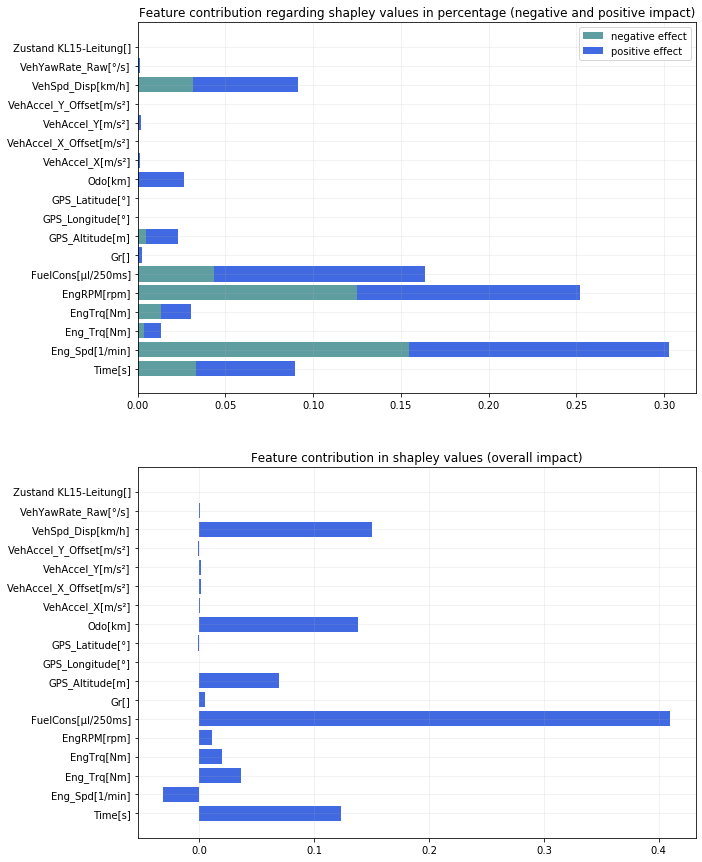

In [560]:
plot_feature_contribution(model, shap_val = shap_val[0][0], feature_names = training_generator.getListOfFeatures(), explanation_for = x_test[:1], label = y_test[:1])

#### Show explanation for next sample regarding Shapley Values

In [561]:
# again
shap.force_plot(shap_explainer.expected_value[0], shap_val[0][1],features=x_test[1:2][0],feature_names=training_generator.getListOfFeatures())

Predicted_class: 0  Probability: 0.99862504
Actual_class:	 0


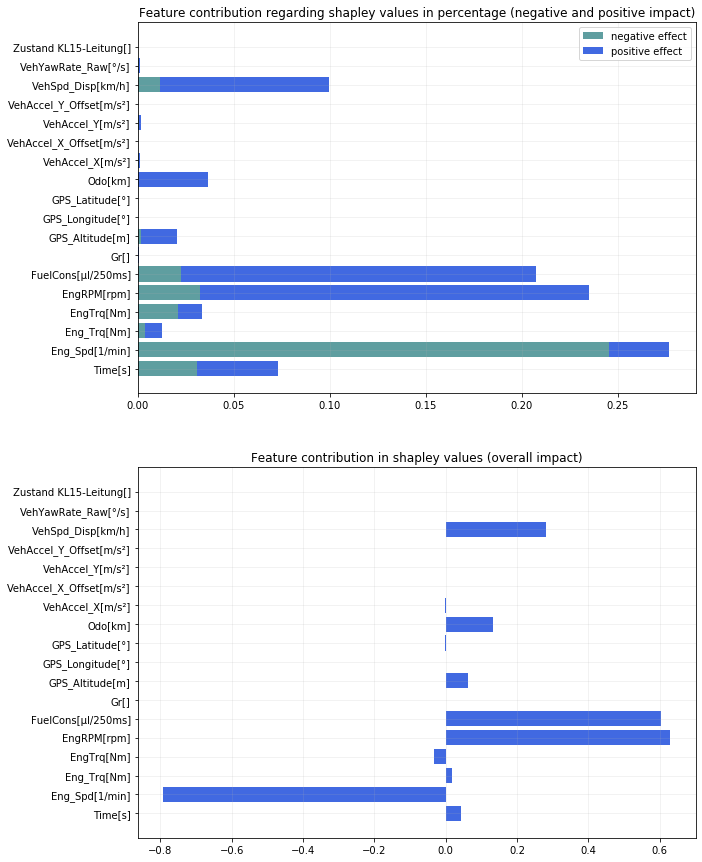

In [562]:
plot_feature_contribution(model, shap_val[0][1],feature_names = training_generator.getListOfFeatures(), explanation_for = x_test[1:2], label = y_test[1:2])

#### Show explanation for next sample regarding Shapley Values

In [563]:
shap.force_plot(shap_explainer.expected_value[0], shap_val[0][2],features=x_test[2:3][0],feature_names=training_generator.getListOfFeatures())

Predicted_class: 0  Probability: 0.9983944
Actual_class:	 0


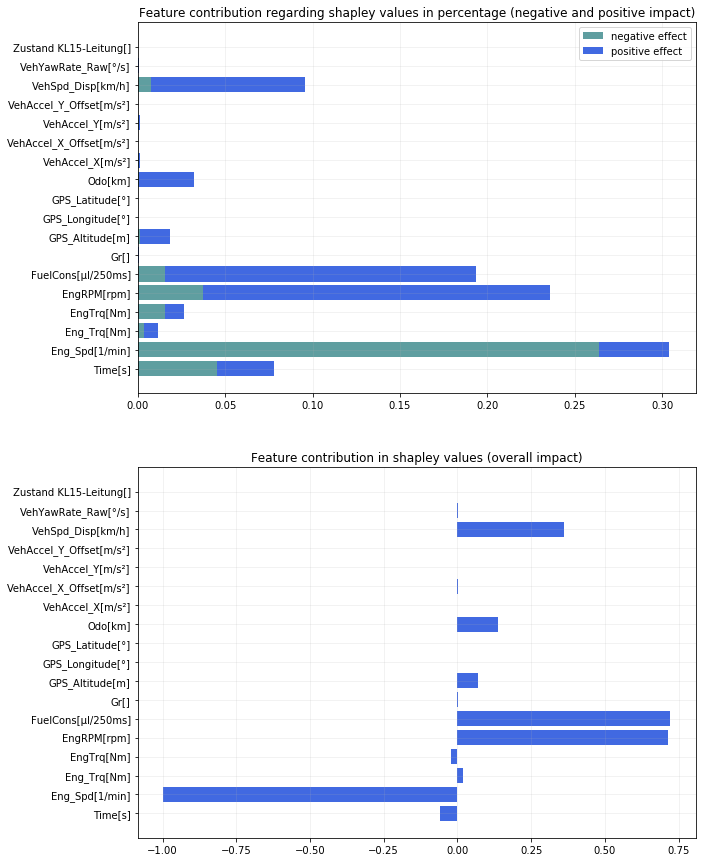

In [564]:
plot_feature_contribution(model, shap_val[0][2],feature_names = training_generator.getListOfFeatures(), explanation_for = x_test[2:3], label = y_test[2:3])

#### Show explanation for next sample regarding Shapley Values

In [568]:
shap.force_plot(shap_explainer.expected_value[0], shap_val[0][3],features=x_test[3:4][0],feature_names=training_generator.getListOfFeatures())

Predicted_class: 0  Probability: 0.9983944
Actual_class:	 0


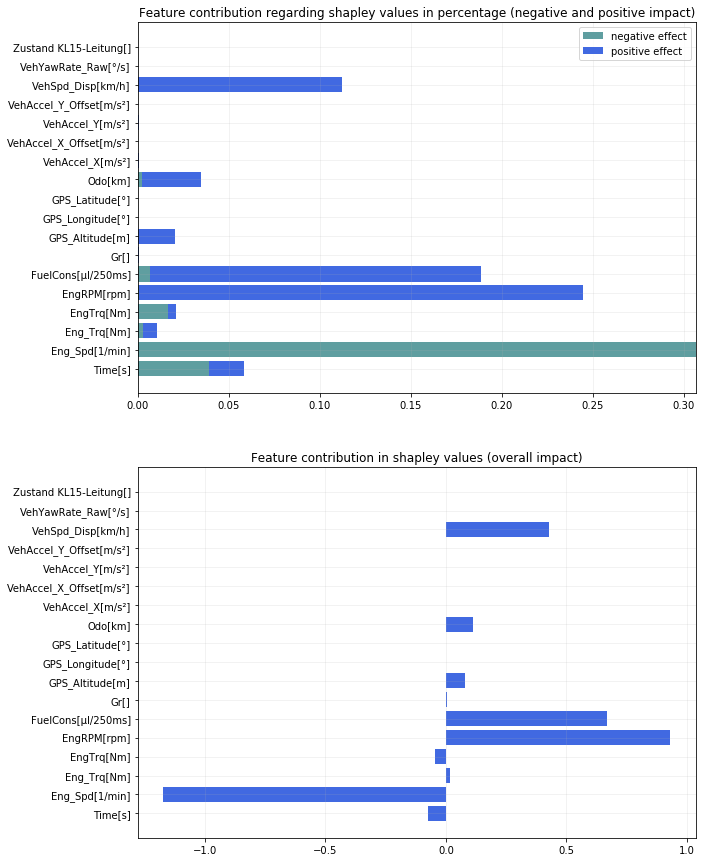

In [566]:
plot_feature_contribution(model, shap_val[0][3],feature_names = training_generator.getListOfFeatures(), explanation_for = x_test[2:3], label = y_test[3:4])

#### Show explanation for next sample regarding Shapley Values

In [571]:
shap_val = shap_explainer.shap_values(x_test[5300:5305])

In [575]:
shap.force_plot(shap_explainer.expected_value[8], shap_val[0][0],features=x_test[5300:5301][0],feature_names=training_generator.getListOfFeatures())

Predicted_class: 8  Probability: 0.793047
Actual_class:	 7


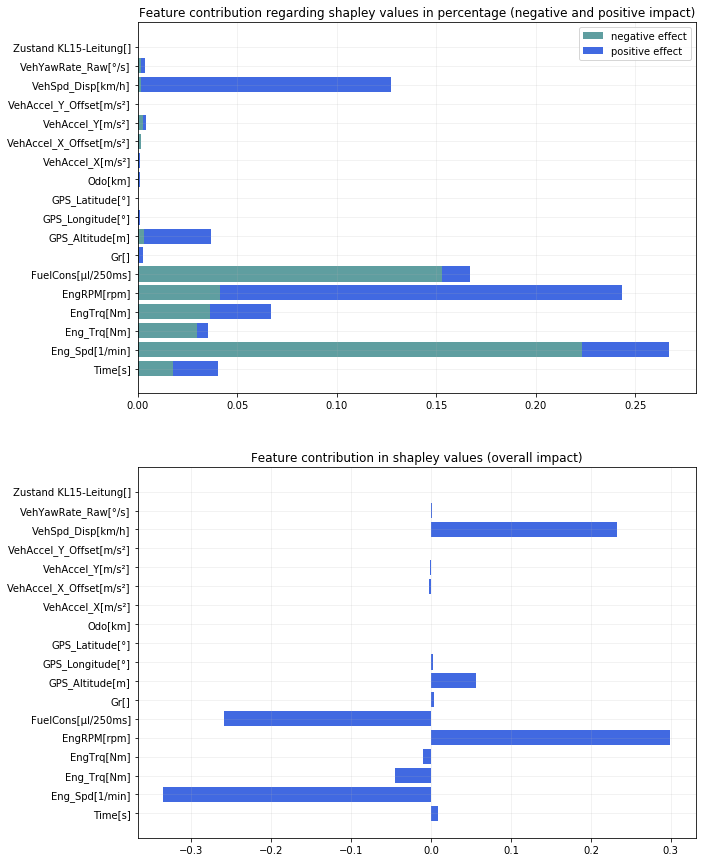

In [573]:
plot_feature_contribution(model, shap_val[0][0],feature_names = training_generator.getListOfFeatures(), explanation_for = x_test[5300:5301], label = y_test[5300:5301])

In [576]:
shap.force_plot(shap_explainer.expected_value[8], shap_val[0][1],features=x_test[5301:5302][0],feature_names=training_generator.getListOfFeatures())

Predicted_class: 8  Probability: 0.6306045
Actual_class:	 7


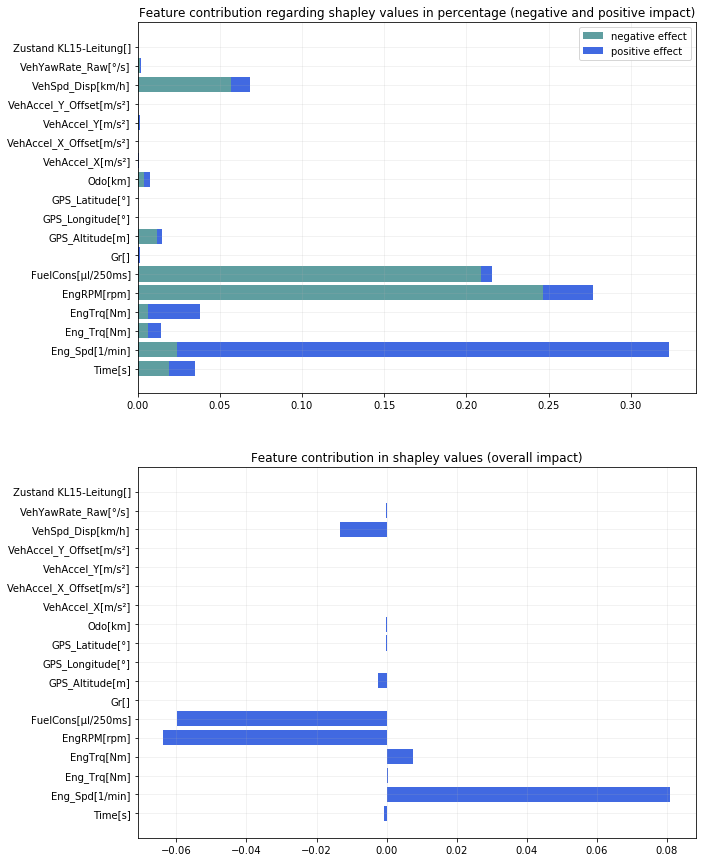

In [577]:
plot_feature_contribution(model, shap_val[0][1],feature_names = training_generator.getListOfFeatures(), explanation_for = x_test[5301:5302], label = y_test[5301:5302])

In [578]:
shap.force_plot(shap_explainer.expected_value[8], shap_val[0][2],features=x_test[5302:5303][0],feature_names=training_generator.getListOfFeatures())

Predicted_class: 8  Probability: 0.57139313
Actual_class:	 7


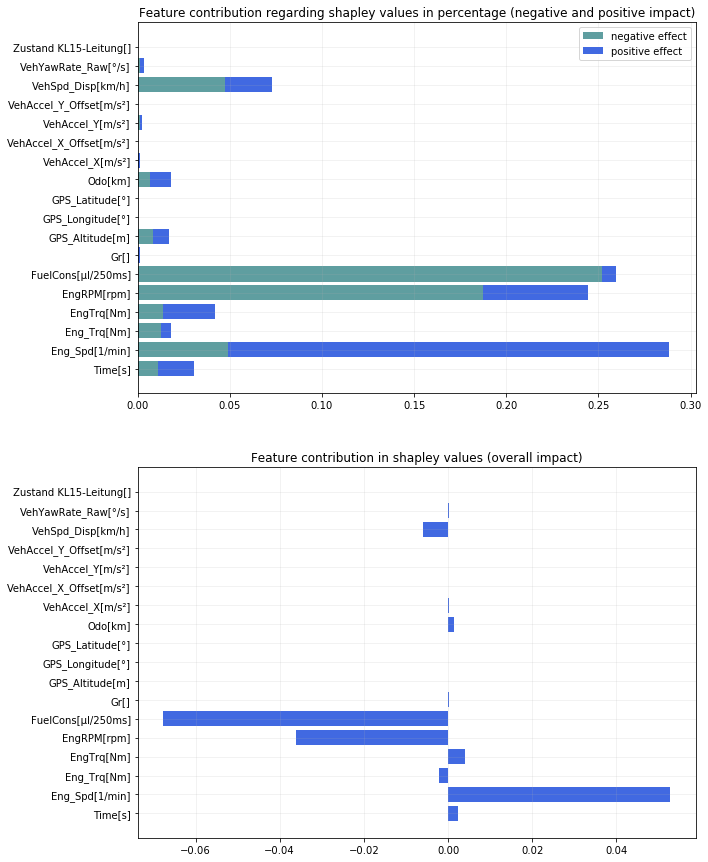

In [579]:
plot_feature_contribution(model, shap_val[0][2],feature_names = training_generator.getListOfFeatures(), explanation_for = x_test[5302:5303], label = y_test[5302:5303])